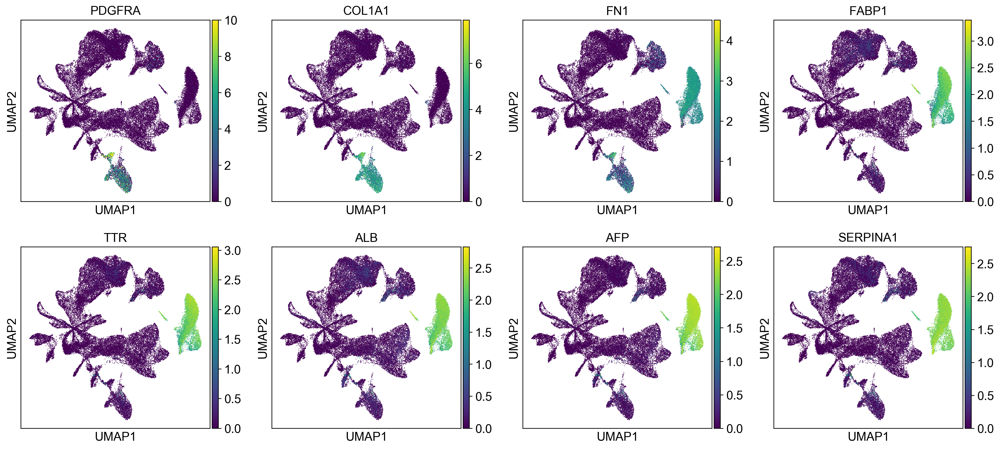

In [17]:
sc.pl.umap(adata, color=['PDGFRA',
'COL1A1',
'FN1',
'FABP1',
'TTR',
'ALB',
'AFP',
'SERPINA1'], use_raw=False)

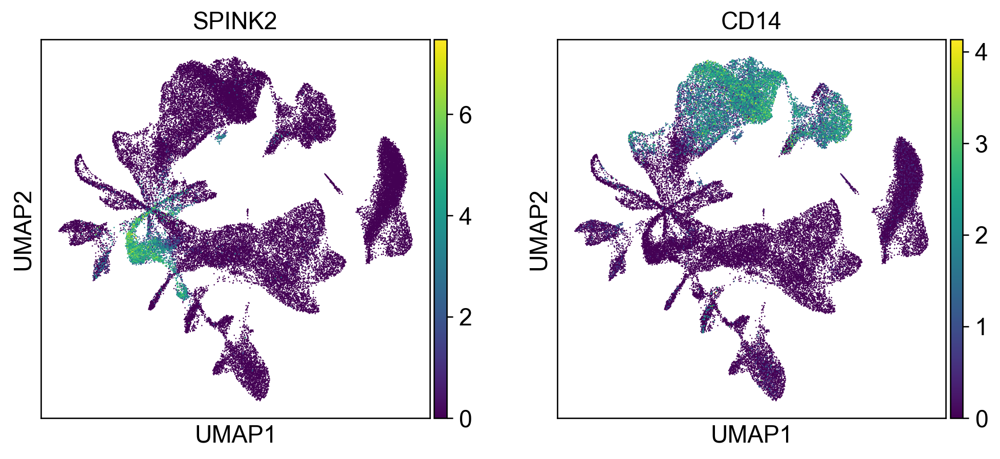

In [18]:
sc.pl.umap(adata, color=['SPINK2', 'CD14'], use_raw=False)

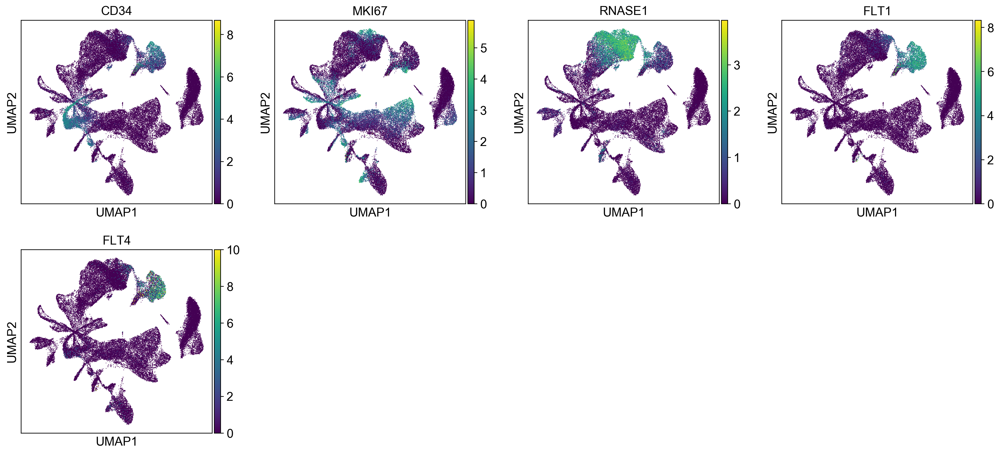

In [22]:
sc.pl.umap(adata, color=['CD34',
'MKI67',
'RNASE1',
'FLT1',
'FLT4'], use_raw=False)

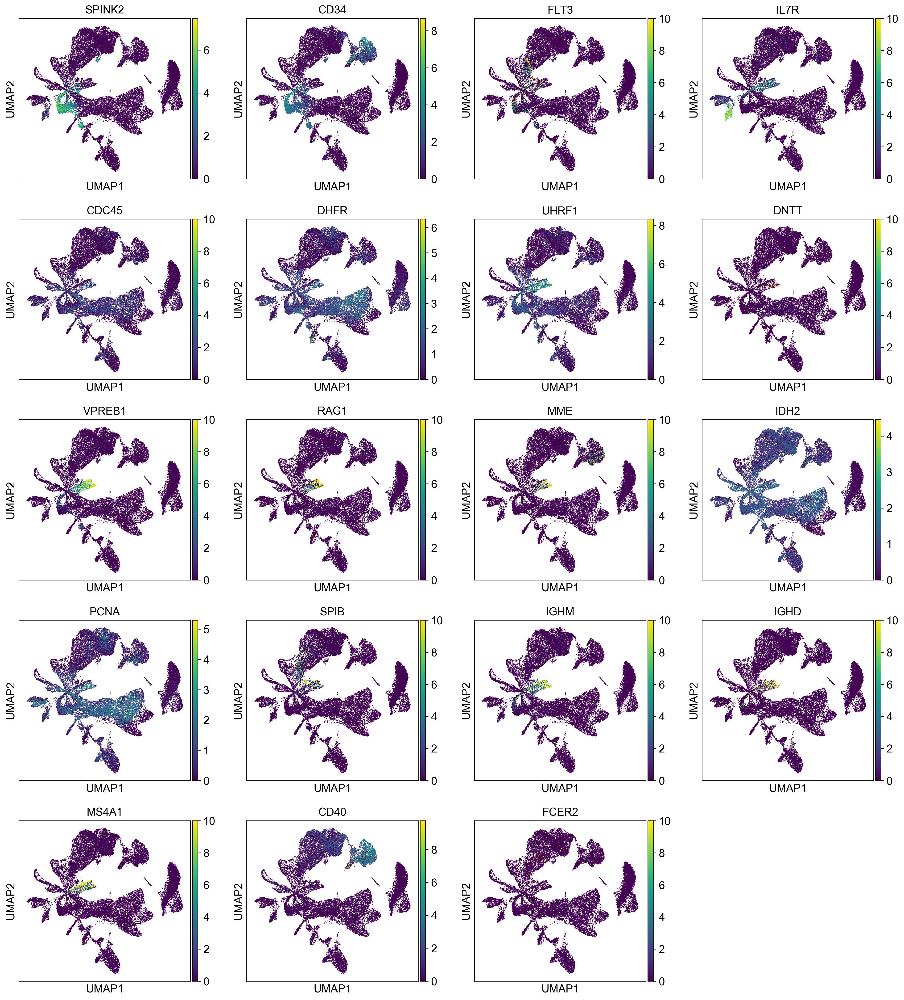

In [23]:
sc.pl.umap(adata, color=['SPINK2', 'CD34', 'FLT3', 'IL7R', 'CDC45', 'DHFR', 'UHRF1', 'DNTT', 'VPREB1', 
                        'RAG1', 'MME', 'IDH2', 'PCNA', 'SPIB', 'IGHM', 'IGHD', 'MS4A1', 'CD40', 'FCER2'], use_raw=False)

In [24]:
genes = ['SPINK2', 'CD34', 'FLT3', 'IL7R', 'CDC45', 'DHFR', 'UHRF1', 'DNTT', 'VPREB1', 'RAG1', 'MME', 'IDH2', 'PCNA', 'SPIB', 'IGHM', 'IGHD', 'MS4A1', 'CD40', 'FCER2']

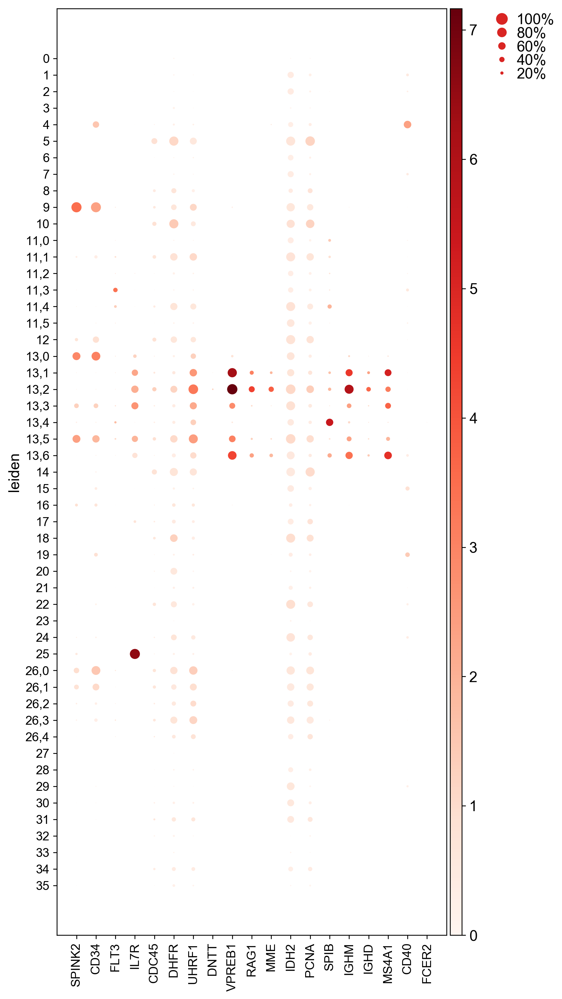

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[6.6499999999999995, 0, 0.2, 0.5, 0.25])

In [26]:
sc.settings.set_figure_params(dpi=120, dpi_save=1000)
sc.pl.dotplot(adata, var_names=genes, groupby="leiden", use_raw=False)

In [32]:
# read in annotation.csv which contains: 'Cluster' column for leiden clusters and 'Category' column for annotations
annotation = pd.read_csv("/Users/b8058304/Documents/PhD_work/Coding/ys/resources_for_pipelines/liver_degs_by_cluster_filtered_20200429.csv", index_col=False)

In [33]:
# convert the clusters column to a string (so that it can be input into the replace function, which acts on strings)
annotation.leiden = annotation.leiden.apply(str)
# make a temp metadata column for new cell labels from the leiden clusters
adata.obs["cell.labels"] = adata.obs["leiden"]

# save the clusters/categories columns as named lists 
clusters = annotation["leiden"].tolist()
categories = annotation["cell.labels"].tolist()
# replace all values in new.cell.labels column matchin clusters values with categories values
adata.obs["cell.labels"] = adata.obs["leiden"].replace(clusters, categories)

In [34]:
adata.obs.groupby(["cell.labels"]).apply(len)

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         1957
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7237
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_B cells_kupffer           32
doublet_HSC_MPP_lownGene        1183
doublet_erythroid_fibroblast      64
doublet_kupffer_HSC              828
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

... storing 'cell.labels' as categorical


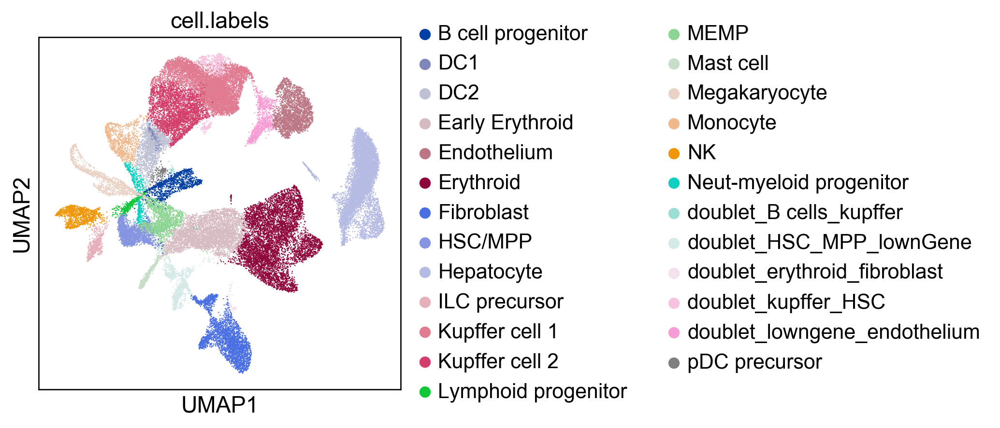

In [35]:
sc.pl.umap(adata, color=['cell.labels'])

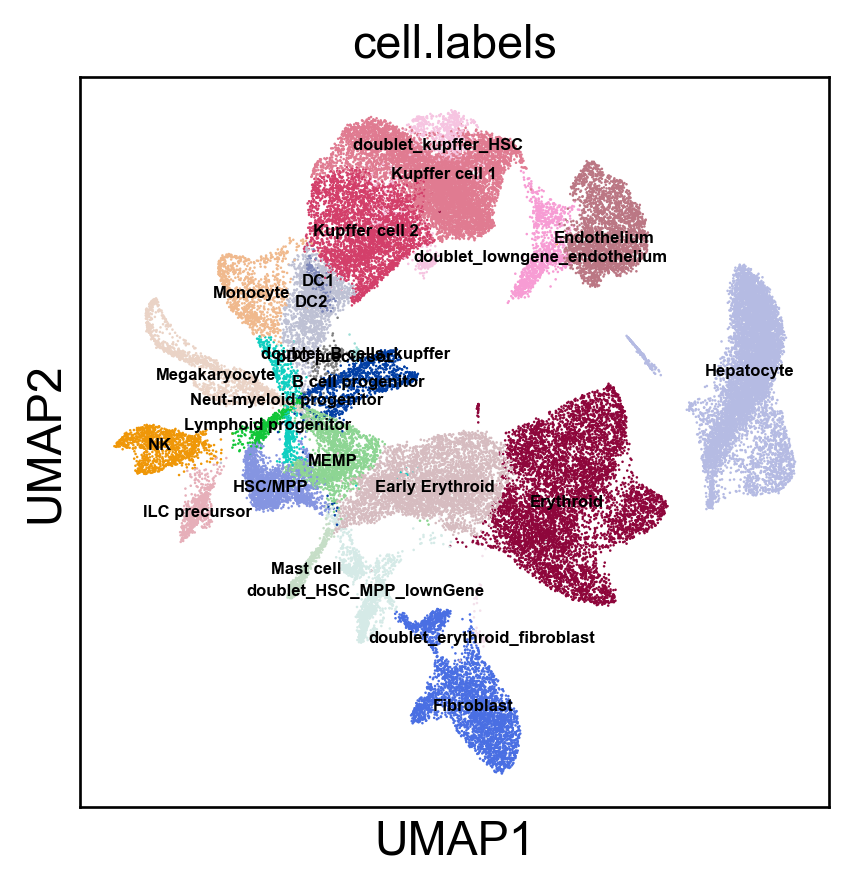

In [36]:
sc.pl.umap(adata, color=['cell.labels'], legend_loc="on data", legend_fontsize=5)

# Remove doublets and cluster out some hybrids

In [ ]:
#Remove doublet_B cells_kupffer ,doublet_erythroid_fibroblast 
#Split doublet_HSC_MPP_lownGene into 2
#Split doublet_kupffer_HSC into ¾???
#Split doublet_lowngene_endothelium into 2 

## Remove doublets

In [39]:
cell_numbers = adata.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         1957
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7237
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_B cells_kupffer           32
doublet_HSC_MPP_lownGene        1183
doublet_erythroid_fibroblast      64
doublet_kupffer_HSC              828
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

In [48]:
subset = adata[~adata.obs['cell.labels'].isin(['doublet_B cells_kupffer', 'doublet_erythroid_fibroblast'])].copy()

In [49]:
cell_numbers = subset.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         1957
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7237
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_HSC_MPP_lownGene        1183
doublet_kupffer_HSC              828
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

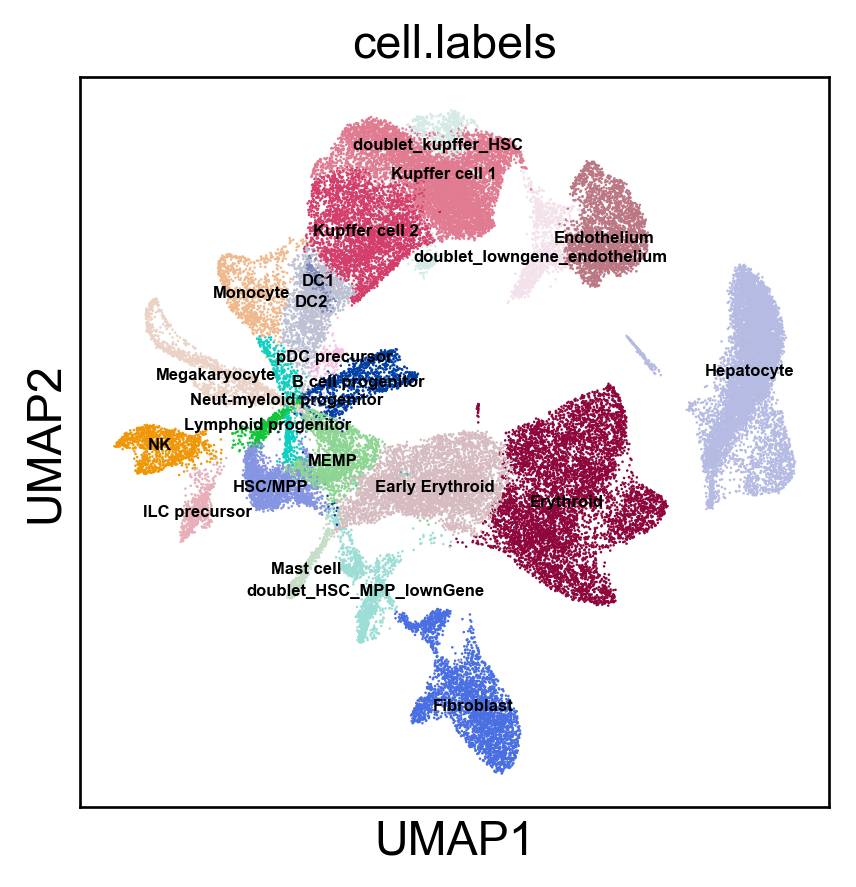

In [50]:
sc.pl.umap(subset, color=['cell.labels'], legend_loc="on data", legend_fontsize=5)

In [51]:
subset.shape

(50760, 25756)

## Split doublet_HSC_MPP_lownGene into 2

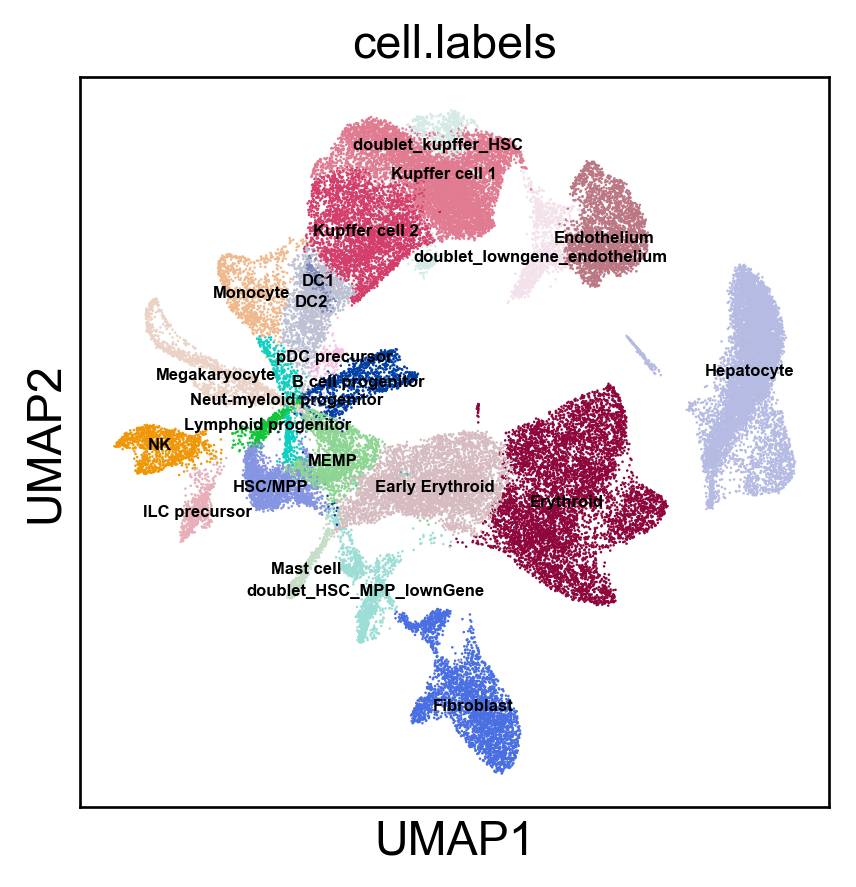

In [52]:
sc.pl.umap(subset, color=['cell.labels'], legend_loc="on data", legend_fontsize=5)

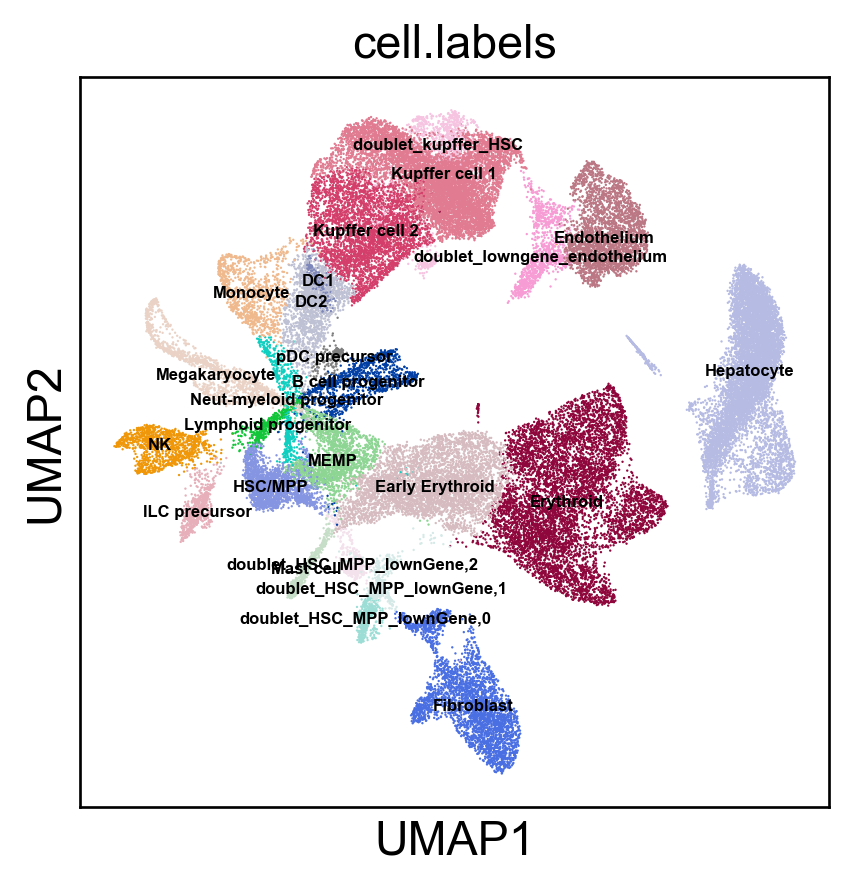

In [53]:
sc.tl.leiden(subset, resolution=0.2, random_state=26, n_iterations=-1, restrict_to=("cell.labels", ["doublet_HSC_MPP_lownGene"]), key_added="cell.labels")
sc.pl.umap(subset, color='cell.labels', legend_loc="on data", size=2, legend_fontsize=5)

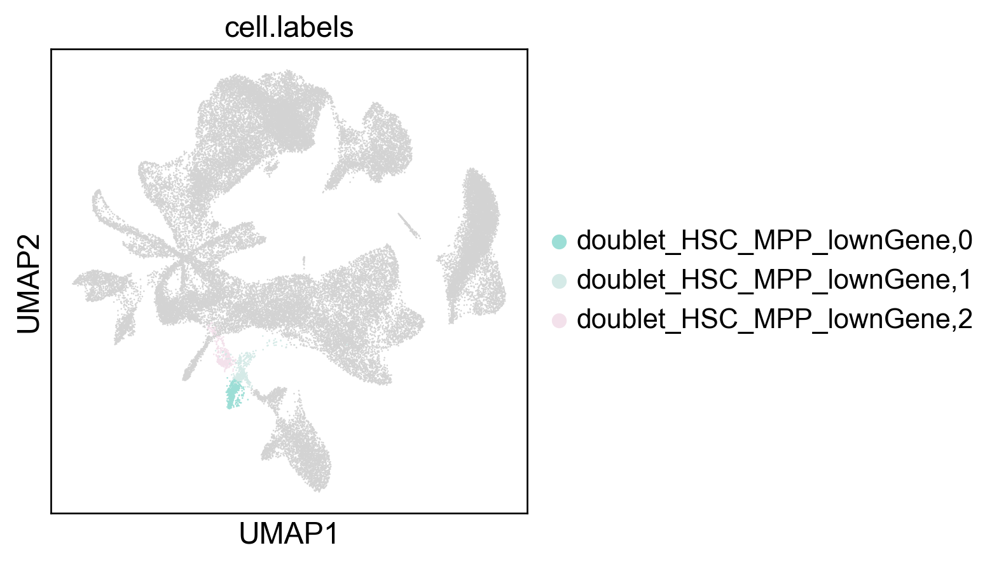

In [56]:
sc.pl.umap(subset, color='cell.labels', groups=["doublet_HSC_MPP_lownGene,0", "doublet_HSC_MPP_lownGene,1", "doublet_HSC_MPP_lownGene,2"])

In [58]:
cell_numbers = subset.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         1957
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7237
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_HSC_MPP_lownGene,0       424
doublet_HSC_MPP_lownGene,1       397
doublet_HSC_MPP_lownGene,2       362
doublet_kupffer_HSC              828
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

In [59]:
subset_2 = subset[~subset.obs['cell.labels'].isin(["doublet_HSC_MPP_lownGene,0", "doublet_HSC_MPP_lownGene,1"])].copy()

In [60]:
cell_numbers = subset_2.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         1957
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7237
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_HSC_MPP_lownGene,2       362
doublet_kupffer_HSC              828
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

In [61]:
# rename doublet_HSC_MPP_lownGene,2 to HSC/MPP
subset_2.obs["cell.labels"] = subset_2.obs["cell.labels"].replace(["doublet_HSC_MPP_lownGene,2"],["HSC/MPP"])

In [62]:
cell_numbers = subset_2.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         2319
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7237
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_kupffer_HSC              828
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

... storing 'cell.labels' as categorical


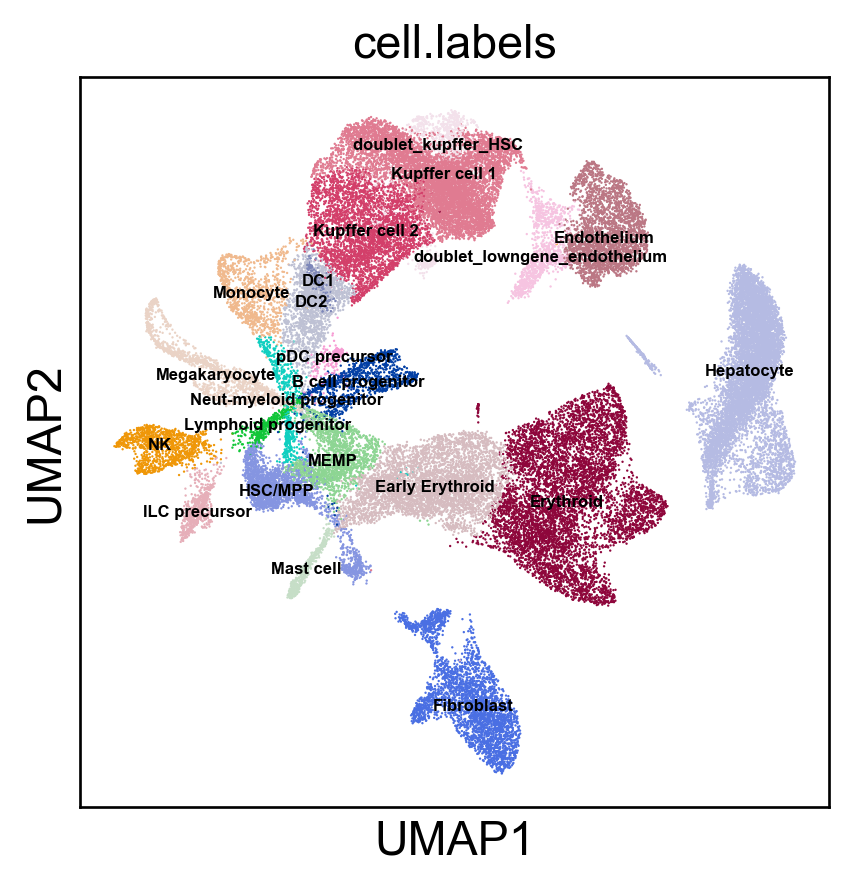

In [63]:
sc.pl.umap(subset_2, color='cell.labels', legend_loc="on data", size=2, legend_fontsize=5)

## Split doublet_kupffer_HSC into ¾???

In [64]:
cell_numbers = subset_2.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         2319
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7237
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_kupffer_HSC              828
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

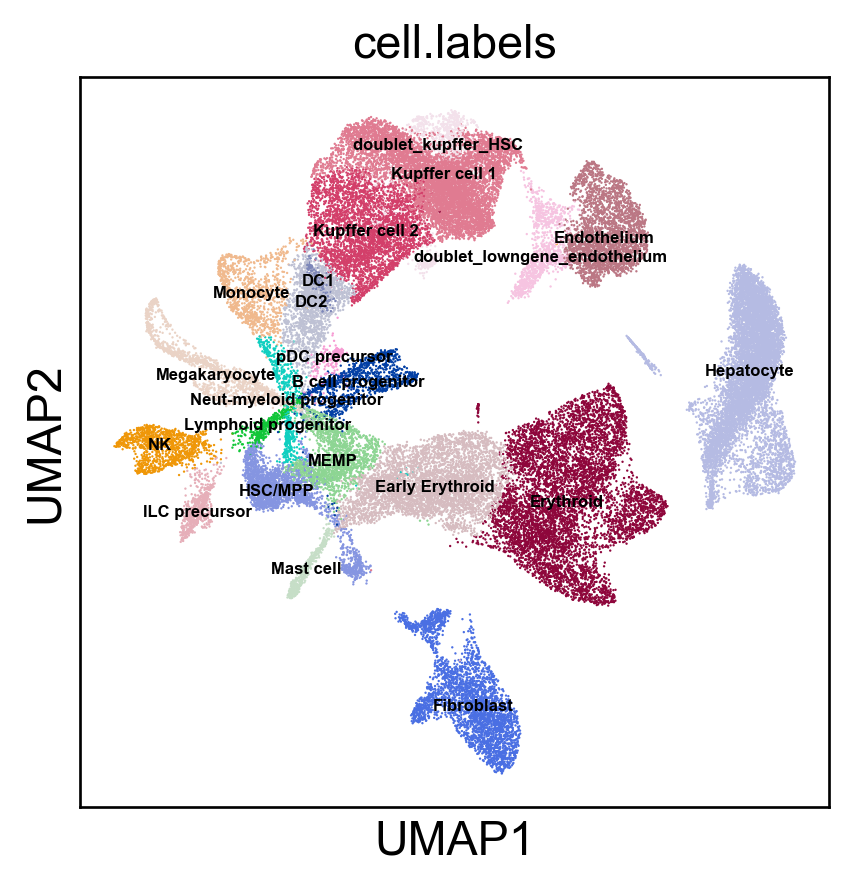

In [65]:
sc.pl.umap(subset_2, color='cell.labels', legend_loc="on data", size=2, legend_fontsize=5)

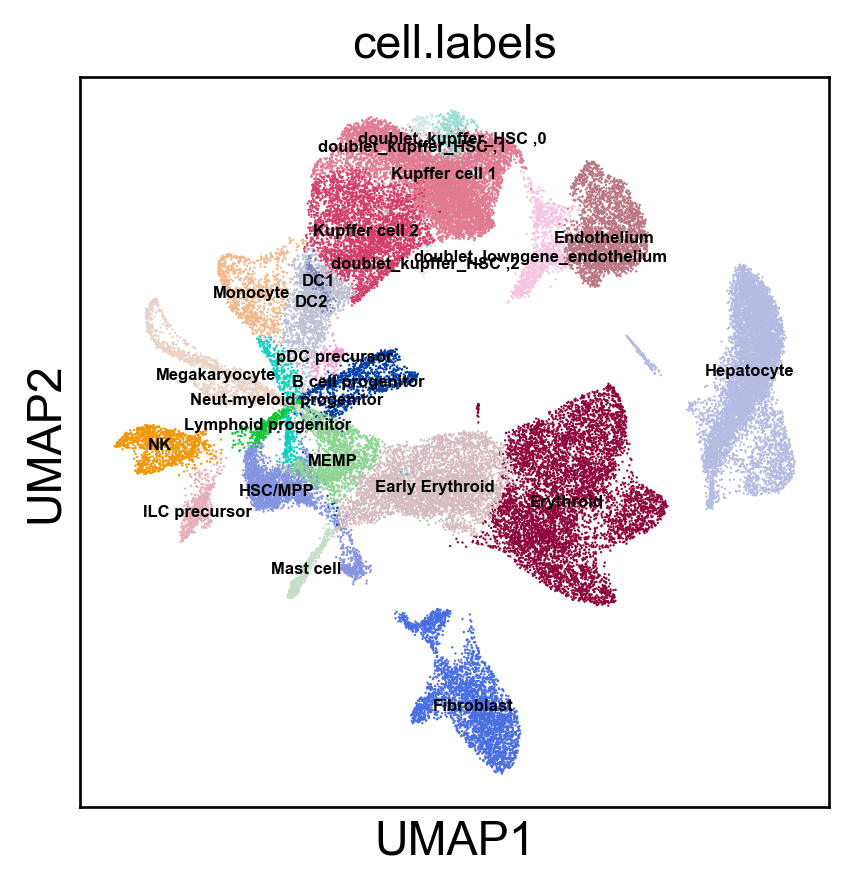

In [67]:
sc.tl.leiden(subset_2, resolution=0.2, random_state=26, n_iterations=-1, restrict_to=("cell.labels", ["doublet_kupffer_HSC "]), key_added="cell.labels")
sc.pl.umap(subset_2, color='cell.labels', legend_loc="on data", size=2, legend_fontsize=5)

In [68]:
cell_numbers = subset_2.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         2319
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7237
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_kupffer_HSC ,0           470
doublet_kupffer_HSC ,1           258
doublet_kupffer_HSC ,2           100
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

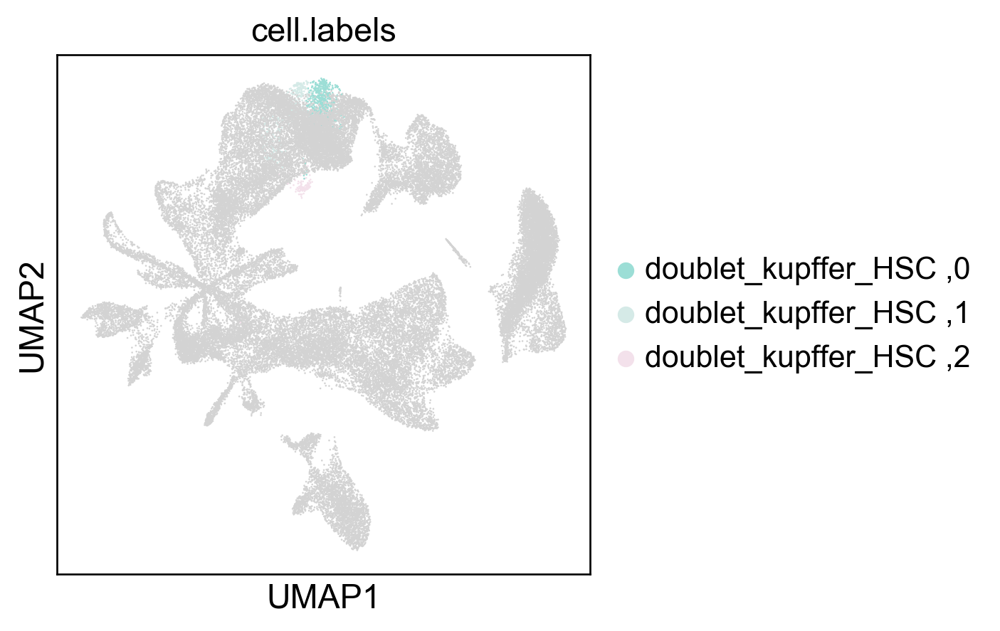

In [69]:
sc.pl.umap(subset_2, color='cell.labels', groups=["doublet_kupffer_HSC ,0", "doublet_kupffer_HSC ,1", "doublet_kupffer_HSC ,2"])

In [70]:
subset_3 = subset_2[~subset_2.obs['cell.labels'].isin(["doublet_kupffer_HSC ,2"])].copy()

In [71]:
cell_numbers = subset_3.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         2319
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7237
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_kupffer_HSC ,0           470
doublet_kupffer_HSC ,1           258
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

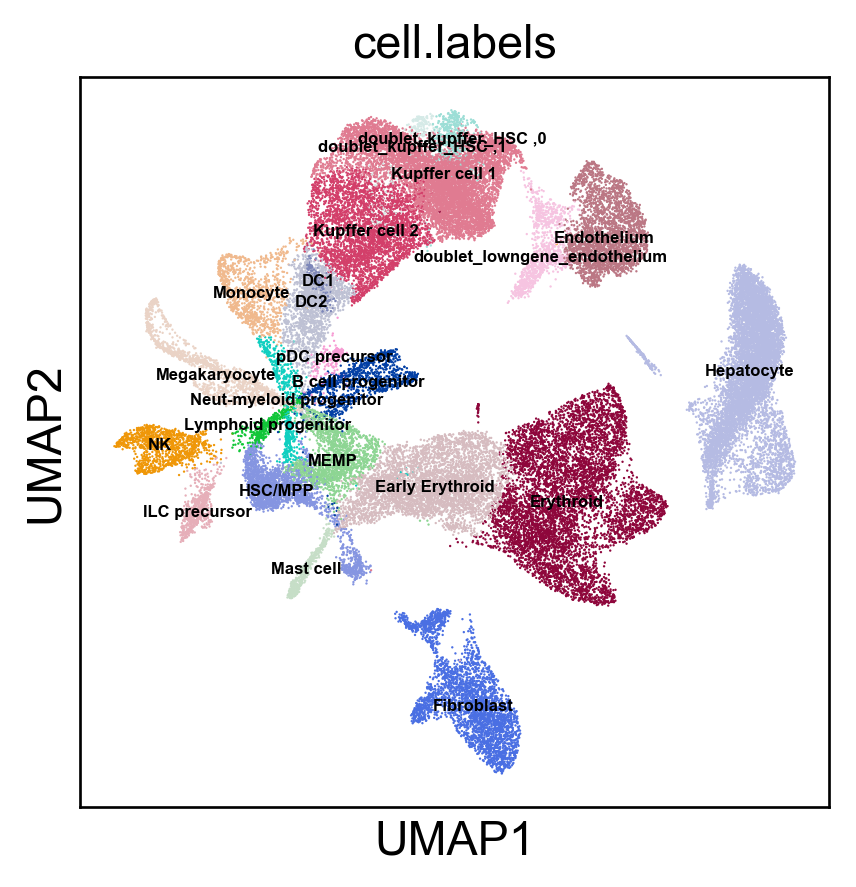

In [73]:
sc.pl.umap(subset_3, color='cell.labels', legend_loc="on data", size=2, legend_fontsize=5)

In [74]:
# rename doublet_kupffer_HSC ,0/1 to kupffer cell 1
subset_3.obs["cell.labels"] = subset_3.obs["cell.labels"].replace(["doublet_kupffer_HSC ,0", "doublet_kupffer_HSC ,1"],["Kupffer cell 1", "Kupffer cell 1"])

In [75]:
cell_numbers = subset_3.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         2319
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7965
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

... storing 'cell.labels' as categorical


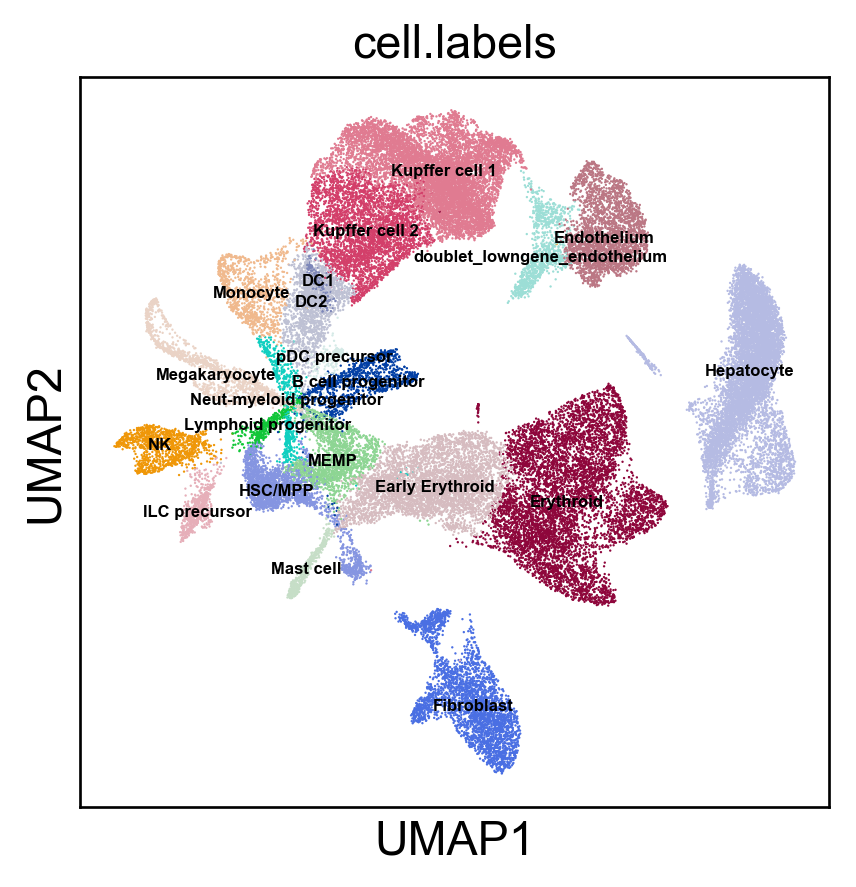

In [76]:
sc.pl.umap(subset_3, color='cell.labels', legend_loc="on data", size=2, legend_fontsize=5)

## Split doublet_lowngene_endothelium into 2 

In [77]:
cell_numbers = subset_3.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor               1098
DC1                              183
DC2                             1586
Early Erythroid                 4270
Endothelium                     2571
Erythroid                       6485
Fibroblast                      3213
HSC/MPP                         2319
Hepatocyte                      8228
ILC precursor                    600
Kupffer cell 1                  7965
Kupffer cell 2                  3536
Lymphoid progenitor              370
MEMP                            1717
Mast cell                        426
Megakaryocyte                   1395
Monocyte                         974
NK                              1111
Neut-myeloid progenitor          550
doublet_lowngene_endothelium    1039
pDC precursor                    203
dtype: int64

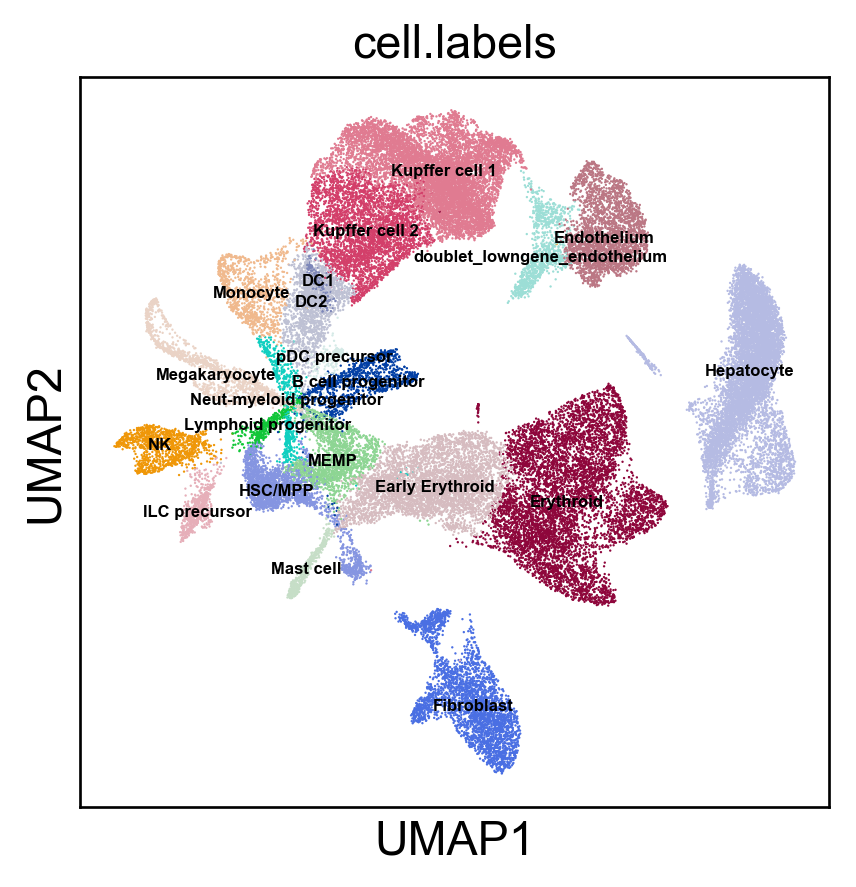

In [78]:
sc.pl.umap(subset_3, color='cell.labels', legend_loc="on data", size=2, legend_fontsize=5)

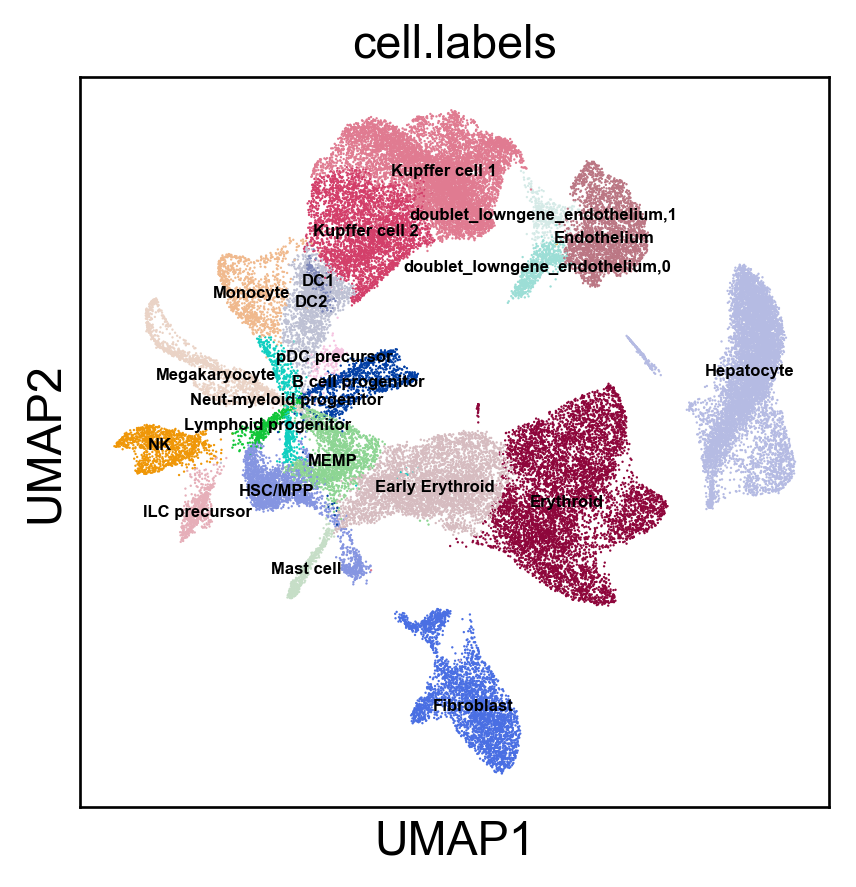

In [79]:
sc.tl.leiden(subset_3, resolution=0.2, random_state=26, n_iterations=-1, restrict_to=("cell.labels", ["doublet_lowngene_endothelium"]), key_added="cell.labels")
sc.pl.umap(subset_3, color='cell.labels', legend_loc="on data", size=2, legend_fontsize=5)

In [80]:
cell_numbers = subset_3.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor                 1098
DC1                                183
DC2                               1586
Early Erythroid                   4270
Endothelium                       2571
Erythroid                         6485
Fibroblast                        3213
HSC/MPP                           2319
Hepatocyte                        8228
ILC precursor                      600
Kupffer cell 1                    7965
Kupffer cell 2                    3536
Lymphoid progenitor                370
MEMP                              1717
Mast cell                          426
Megakaryocyte                     1395
Monocyte                           974
NK                                1111
Neut-myeloid progenitor            550
doublet_lowngene_endothelium,0     685
doublet_lowngene_endothelium,1     354
pDC precursor                      203
dtype: int64

In [81]:
subset_4 = subset_3[~subset_3.obs['cell.labels'].isin(["doublet_lowngene_endothelium,1"])].copy()

In [82]:
cell_numbers = subset_4.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor                 1098
DC1                                183
DC2                               1586
Early Erythroid                   4270
Endothelium                       2571
Erythroid                         6485
Fibroblast                        3213
HSC/MPP                           2319
Hepatocyte                        8228
ILC precursor                      600
Kupffer cell 1                    7965
Kupffer cell 2                    3536
Lymphoid progenitor                370
MEMP                              1717
Mast cell                          426
Megakaryocyte                     1395
Monocyte                           974
NK                                1111
Neut-myeloid progenitor            550
doublet_lowngene_endothelium,0     685
pDC precursor                      203
dtype: int64

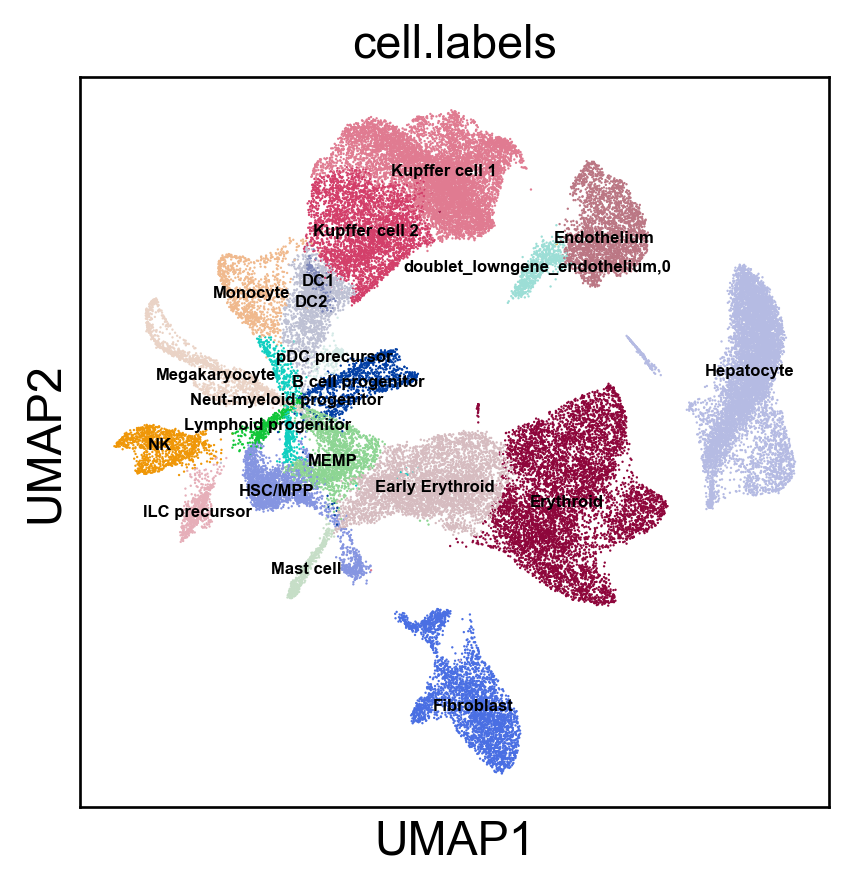

In [83]:
sc.pl.umap(subset_4, color='cell.labels', legend_loc="on data", size=2, legend_fontsize=5)

In [84]:
# rename doublet_lowngene_endothelium,0 to endo
subset_4.obs["cell.labels"] = subset_4.obs["cell.labels"].replace(["doublet_lowngene_endothelium,0"],["Endothelium"])

In [85]:
cell_numbers = subset_4.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
B cell progenitor          1098
DC1                         183
DC2                        1586
Early Erythroid            4270
Endothelium                3256
Erythroid                  6485
Fibroblast                 3213
HSC/MPP                    2319
Hepatocyte                 8228
ILC precursor               600
Kupffer cell 1             7965
Kupffer cell 2             3536
Lymphoid progenitor         370
MEMP                       1717
Mast cell                   426
Megakaryocyte              1395
Monocyte                    974
NK                         1111
Neut-myeloid progenitor     550
pDC precursor               203
dtype: int64

... storing 'cell.labels' as categorical


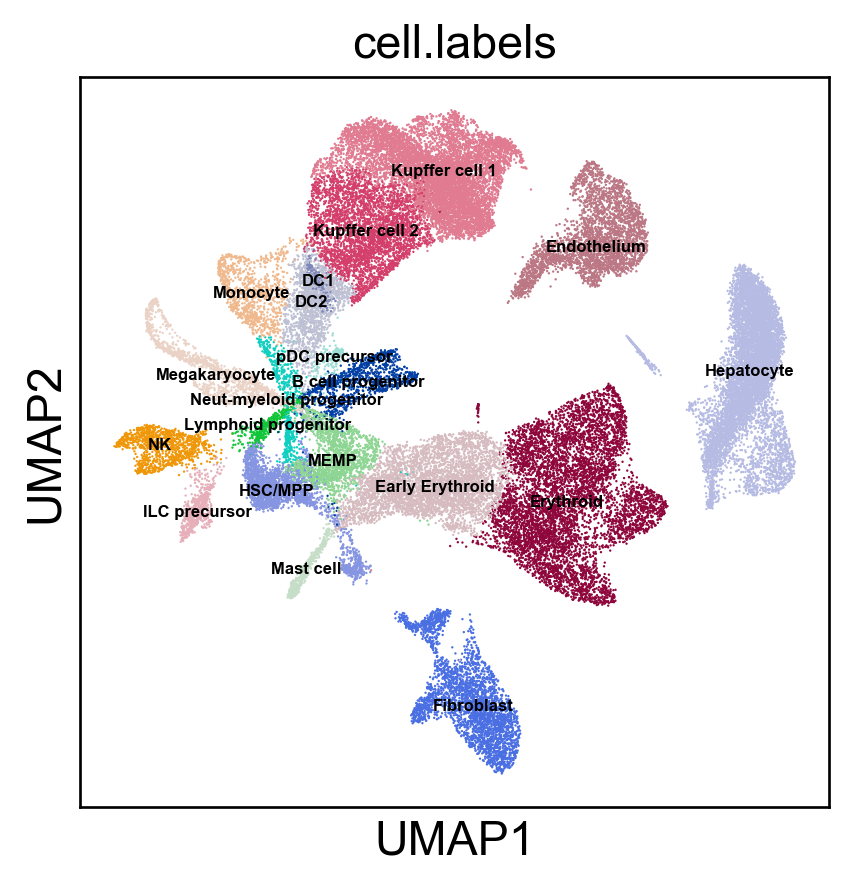

In [86]:
sc.pl.umap(subset_4, color='cell.labels', legend_loc="on data", size=2, legend_fontsize=5)

In [90]:
pd.DataFrame(subset_4.obs["cell.labels"])

,cell.labels
index,
F61_Liver_CD45+_FCAImmP7862084_AAACCTGAGACCGGAT,HSC/MPP
F61_Liver_CD45+_FCAImmP7862084_AAACCTGAGCTACCGC,Kupffer cell 1
F61_Liver_CD45+_FCAImmP7862084_AAACCTGAGTCCGGTC,Kupffer cell 2
F61_Liver_CD45+_FCAImmP7862084_AAACCTGCAAGTAATG,Hepatocyte
F61_Liver_CD45+_FCAImmP7862084_AAACCTGCACCACGTG,Kupffer cell 1
...,...
F32_Liver_CD45-_FCAImmP7316895_TTTGTCAAGGTGCACA,Early Erythroid
F32_Liver_CD45-_FCAImmP7316895_TTTGTCAAGTACGCCC,Hepatocyte
F32_Liver_CD45-_FCAImmP7316895_TTTGTCACAAGCGATG,Early Erythroid


In [92]:
subset_4.shape

(49485, 25756)

In [93]:
pd.DataFrame(subset_4.obs["cell.labels"]).to_csv('/Users/b8058304/Documents/PhD_work/Coding/ys/resources_for_pipelines/ys_liver_singlet_metadata_20200430.csv')